# Business Understanding

This dataset contains aviation data, from these years, and etc. etc. 

Your analysis should yield three concrete business recommendations. The key idea behind dealing with missing values, aggregating and visualizaing data is to help your organization make data driven decisions. You will relate your findings to business intelligence by making recommendations for how the business should move forward with the new aviation opportunity.

Communicating about your work well is extremely important. Your ability to provide value to an organization - or to land a job there - is directly reliant on your ability to communicate with them about what you have done and why it is valuable. Create a storyline your audience (the head of the aviation division) can follow by walking them through the steps of your process, highlighting the most important points and skipping over the rest.

Use plenty of visualizations. Visualizations are invaluable for exploring your data and making your findings accessible to a non-technical audience. Spotlight visuals in your presentation, but only ones that relate directly to your recommendations. Simple visuals are usually best (e.g. bar charts and line graphs), and don't forget to format them well (e.g. labels, titles).

# Data Understanding (what is the dataset, source, importing)

In [38]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import matplotlib.pyplot as plt
%matplotlib inline

In [39]:
df=pd.read_csv('AviationData.csv', encoding = 'Windows-1252', dtype ={'Latitude':str, 'Longitude':str, 'Broad.phase.of.flight':str})

# Aviation Crash Data

These records range from 1903 to 2005 and include information aboeut the type of plane involved in each incident, as well as the date,  geographical location, weather conditions, and other details about the flight. 

In [40]:
df.head(20)

,Event.Id,Investigation.Type,Accident.Number,Event.Date,Location,Country,Latitude,Longitude,Airport.Code,Airport.Name,Injury.Severity,Aircraft.damage,Aircraft.Category,Registration.Number,Make,Model,Amateur.Built,Number.of.Engines,Engine.Type,FAR.Description,Schedule,Purpose.of.flight,Air.carrier,Total.Fatal.Injuries,Total.Serious.Injuries,Total.Minor.Injuries,Total.Uninjured,Weather.Condition,Broad.phase.of.flight,Report.Status,Publication.Date
0,20001218X45444,Accident,SEA87LA080,1948-10-24,"MOOSE CREEK, ID",United States,NaN,NaN,NaN,NaN,Fatal(2),Destroyed,NaN,NC6404,Stinson,108-3,No,1.0,Reciprocating,NaN,NaN,Personal,NaN,2.0,0.0,0.0,0.0,UNK,Cruise,Probable Cause,NaN
1,20001218X45447,Accident,LAX94LA336,1962-07-19,"BRIDGEPORT, CA",United States,NaN,NaN,NaN,NaN,Fatal(4),Destroyed,NaN,N5069P,Piper,PA24-180,No,1.0,Reciprocating,NaN,NaN,Personal,NaN,4.0,0.0,0.0,0.0,UNK,Unknown,Probable Cause,19-09-1996
2,20061025X01555,Accident,NYC07LA005,1974-08-30,"Saltville, VA",United States,36.922223,-81.878056,NaN,NaN,Fatal(3),Destroyed,NaN,N5142R,Cessna,172M,No,1.0,Reciprocating,NaN,NaN,Personal,NaN,3.0,NaN,NaN,NaN,IMC,Cruise,Probable Cause,26-02-2007
3,20001218X45448,Accident,LAX96LA321,1977-06-19,"EUREKA, CA",United States,NaN,NaN,NaN,NaN,Fatal(2),Destroyed,NaN,N1168J,Rockwell,112,No,1.0,Reciprocating,NaN,NaN,Personal,NaN,2.0,0.0,0.0,0.0,IMC,Cruise,Probable Cause,12-09-2000
4,20041105X01764,Accident,CHI79FA064,1979-08-02,"Canton, OH",United States,NaN,NaN,NaN,NaN,Fatal(1),Destroyed,NaN,N15NY,Cessna,501,No,NaN,NaN,NaN,NaN,Personal,NaN,1.0,2.0,NaN,0.0,VMC,Approach,Probable Cause,16-04-1980
5,20170710X52551,Accident,NYC79AA106,1979-09-17,"BOSTON, MA",United States,42.445277,-70.758333,NaN,NaN,Non-Fatal,Substantial,Airplane,CF-TLU,Mcdonnell Douglas,DC9,No,2.0,Turbo Fan,Part 129: Foreign,SCHD,NaN,Air Canada,NaN,NaN,1.0,44.0,VMC,Climb,Probable Cause,19-09-2017
6,20001218X45446,Accident,CHI81LA106,1981-08-01,"COTTON, MN",United States,NaN,NaN,NaN,NaN,Fatal(4),Destroyed,NaN,N4988E,Cessna,180,No,1.0,Reciprocating,NaN,NaN,Personal,NaN,4.0,0.0,0.0,0.0,IMC,Unknown,Probable Cause,06-11-2001
7,20020909X01562,Accident,SEA82DA022,1982-01-01,"PULLMAN, WA",United States,NaN,NaN,NaN,BLACKBURN AG STRIP,Non-Fatal,Substantial,Airplane,N2482N,Cessna,140,No,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,0.0,0.0,0.0,2.0,VMC,Takeoff,Probable Cause,01-01-1982
8,20020909X01561,Accident,NYC82DA015,1982-01-01,"EAST HANOVER, NJ",United States,NaN,NaN,N58,HANOVER,Non-Fatal,Substantial,Airplane,N7967Q,Cessna,401B,No,2.0,Reciprocating,Part 91: General Aviation,NaN,Business,NaN,0.0,0.0,0.0,2.0,IMC,Landing,Probable Cause,01-01-1982
9,20020909X01560,Accident,MIA82DA029,1982-01-01,"JACKSONVILLE, FL",United States,NaN,NaN,JAX,JACKSONVILLE INTL,Non-Fatal,Substantial,NaN,N3906K,North American,NAVION L-17B,No,1.0,Reciprocating,NaN,NaN,Personal,NaN,0.0,0.0,3.0,0.0,IMC,Cruise,Probable Cause,01-01-1982


In [41]:
df['Report.Status'].value_counts()

Report.Status
Probable Cause                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                            

In [28]:
#A list of the categories included in the dataset 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88889 entries, 0 to 88888
Data columns (total 31 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Event Id                88889 non-null  object 
 1   Investigation Type      88889 non-null  object 
 2   Accident Number         88889 non-null  object 
 3   Event Date              88889 non-null  object 
 4   Location                88837 non-null  object 
 5   Country                 88663 non-null  object 
 6   Latitude                34382 non-null  object 
 7   Longitude               34373 non-null  object 
 8   Airport Code            50132 non-null  object 
 9   Airport Name            52704 non-null  object 
 10  Injury Severity         87889 non-null  object 
 11  Aircraft Damage         85695 non-null  object 
 12  Aircraft Category       32287 non-null  object 
 13  Registration Number     87507 non-null  object 
 14  Make                    88826 non-null

This dataset contains 31 columns with various categories and data points, and a total of 88,888 total recorded incidents. 

In [29]:
#cleaning up column names for easier handling
df.columns = [col.replace('.', ' ').title() for col in df.columns]
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88889 entries, 0 to 88888
Data columns (total 31 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Event Id                88889 non-null  object 
 1   Investigation Type      88889 non-null  object 
 2   Accident Number         88889 non-null  object 
 3   Event Date              88889 non-null  object 
 4   Location                88837 non-null  object 
 5   Country                 88663 non-null  object 
 6   Latitude                34382 non-null  object 
 7   Longitude               34373 non-null  object 
 8   Airport Code            50132 non-null  object 
 9   Airport Name            52704 non-null  object 
 10  Injury Severity         87889 non-null  object 
 11  Aircraft Damage         85695 non-null  object 
 12  Aircraft Category       32287 non-null  object 
 13  Registration Number     87507 non-null  object 
 14  Make                    88826 non-null

In [30]:
df.isna().sum()

Event Id                      0
Investigation Type            0
Accident Number               0
Event Date                    0
Location                     52
Country                     226
Latitude                  54507
Longitude                 54516
Airport Code              38757
Airport Name              36185
Injury Severity            1000
Aircraft Damage            3194
Aircraft Category         56602
Registration Number        1382
Make                         63
Model                        92
Amateur Built               102
Number Of Engines          6084
Engine Type                7096
Far Description           56866
Schedule                  76307
Purpose Of Flight          6192
Air Carrier               72241
Total Fatal Injuries      11401
Total Serious Injuries    12510
Total Minor Injuries      11933
Total Uninjured            5912
Weather Condition          4492
Broad Phase Of Flight     27165
Report Status              6384
Publication Date          13771
dtype: i

# Data Preparation

## Removing Superfluous Data

For the purposes of this research, a number of data points are superfluous. I don't want to include any amateur built planes, any unusual aircraft, or any data that doesn't directly relate to the incident or injuries involved. 



In [31]:
df = df.dropna(subset=['Make', 'Model'])


In [37]:
df.head()

Make
cessna    27145
piper     14869
beech      5371
boeing     2738
bell       2722
Name: count, dtype: int64

In [36]:
df['Report Status'].value_counts()

KeyError: 'Report Status'

In [35]:
df=df['make'].str.lower().value_counts()

KeyError: 'make'

In [34]:
df['Make'].unique()

KeyError: 'Make'

In [33]:
#get unique values in make, model, engine type and amount, air carrier?
#look for correlations between make and model and engines, maybe null values can be filled
print(df['Make'].value_counts())

KeyError: 'Make'

In [319]:
#find unqique values to account for any white space, null values, typos, etc.
print(df['Amateur Built'].unique())

['No' 'Yes' nan]


In [17]:
df_sorted = df.sort_values(by='Make')

df['Make'].value_counts()

TypeError: sort_values() got an unexpected keyword argument 'by'

In [320]:
#remove any rows that don't confirm professionally built planes
df = df[(df['Amateur Built'] != 'Yes') & df['Amateur Built'].notna()]

Now that all the planes in the dataset are professionally built aircraft, we can drop the column 'Amateur.Built'. The Registration number of the planes and the country where the crash took place aren't important for our needs, so we'll drop those as well. 

In [321]:
#Now that all incidents include professionally-built aircraft, we can drop the 'Amateur.Built' columns. dropping irrelevant columns
df=df.drop(['Event Id', 'Accident Number', 'Amateur Built', 'Registration Number', ], axis =1)

In [322]:
df.shape

(80240, 27)

For our purposes we are only interested in 

In [323]:
df['Aircraft Category'].value_counts()

Aircraft Category
Airplane             24398
Helicopter            3294
Glider                 476
Balloon                229
Weight-Shift           139
Powered Parachute       83
Gyrocraft               32
Ultralight              18
Unknown                 11
WSFT                     9
Powered-Lift             5
Blimp                    4
UNK                      2
Rocket                   1
Name: count, dtype: int64

In [324]:
df=df[df['Aircraft Category']=='Airplane']
df=df.drop(['Aircraft Category'], axis=1)

In [325]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24398 entries, 5 to 88886
Data columns (total 26 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Investigation Type      24398 non-null  object 
 1   Event Date              24398 non-null  object 
 2   Location                24392 non-null  object 
 3   Country                 24391 non-null  object 
 4   Latitude                19162 non-null  object 
 5   Longitude               19156 non-null  object 
 6   Airport Code            15477 non-null  object 
 7   Airport Name            15973 non-null  object 
 8   Injury Severity         23587 non-null  object 
 9   Aircraft Damage         23131 non-null  object 
 10  Make                    24398 non-null  object 
 11  Model                   24398 non-null  object 
 12  Number Of Engines       21852 non-null  float64
 13  Engine Type             20455 non-null  object 
 14  Far Description         23918 non-null  obj

In [326]:
df.head(30)

,Investigation Type,Event Date,Location,Country,Latitude,Longitude,Airport Code,Airport Name,Injury Severity,Aircraft Damage,Make,Model,Number Of Engines,Engine Type,Far Description,Schedule,Purpose Of Flight,Air Carrier,Total Fatal Injuries,Total Serious Injuries,Total Minor Injuries,Total Uninjured,Weather Condition,Broad Phase Of Flight,Report Status,Publication Date
5,Accident,1979-09-17,"BOSTON, MA",United States,42.445277,-70.758333,NaN,NaN,Non-Fatal,Substantial,Mcdonnell Douglas,DC9,2.0,Turbo Fan,Part 129: Foreign,SCHD,NaN,Air Canada,NaN,NaN,1.0,44.0,VMC,Climb,Probable Cause,19-09-2017
7,Accident,1982-01-01,"PULLMAN, WA",United States,NaN,NaN,NaN,BLACKBURN AG STRIP,Non-Fatal,Substantial,Cessna,140,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,0.0,0.0,0.0,2.0,VMC,Takeoff,Probable Cause,01-01-1982
8,Accident,1982-01-01,"EAST HANOVER, NJ",United States,NaN,NaN,N58,HANOVER,Non-Fatal,Substantial,Cessna,401B,2.0,Reciprocating,Part 91: General Aviation,NaN,Business,NaN,0.0,0.0,0.0,2.0,IMC,Landing,Probable Cause,01-01-1982
12,Accident,1982-01-02,"HOMER, LA",United States,NaN,NaN,NaN,NaN,Non-Fatal,Destroyed,Bellanca,17-30A,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,0.0,0.0,1.0,0.0,IMC,Cruise,Probable Cause,02-01-1983
13,Accident,1982-01-02,"HEARNE, TX",United States,NaN,NaN,T72,HEARNE MUNICIPAL,Fatal(1),Destroyed,Cessna,R172K,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,1.0,0.0,0.0,0.0,IMC,Takeoff,Probable Cause,02-01-1983
14,Accident,1982-01-02,"CHICKASHA, OK",United States,NaN,NaN,NaN,NaN,Fatal(1),Destroyed,Navion,A,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,1.0,0.0,0.0,0.0,IMC,Cruise,Probable Cause,02-01-1983
15,Accident,1982-01-02,"LITTLE ROCK, AR",United States,NaN,NaN,NaN,NaN,Fatal(2),Destroyed,Beech,19,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,2.0,0.0,0.0,0.0,IMC,Cruise,Probable Cause,02-01-1983
17,Accident,1982-01-02,"SKWENTA, AK",United States,NaN,NaN,NaN,NaN,Fatal(3),Destroyed,Cessna,180,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,3.0,0.0,0.0,0.0,VMC,Unknown,Probable Cause,02-01-1983
18,Accident,1982-01-02,"GALETON, PA",United States,NaN,NaN,5G6,CHERRY SPRINGS,Non-Fatal,Substantial,Cessna,172,1.0,Reciprocating,Part 91: General Aviation,NaN,Personal,NaN,0.0,0.0,0.0,1.0,VMC,Taxi,Probable Cause,02-01-1983
20,Accident,1982-01-02,"YPSILANTI, MI",United States,NaN,NaN,YIP,WILLOW RUN,Non-Fatal,Substantial,Cessna,152,1.0,Reciprocating,Part 91: General Aviation,NaN,Instructional,NaN,0.0,0.0,0.0,1.0,VMC,Takeoff,Probable Cause,02-01-1983


# Exploratory Data Analysis

In [327]:
df = df[df['Model'].map(df['Model'].value_counts()) >= 100]


df['Model'].value_counts()

Model
172          869
152          449
737          403
182          344
172N         315
172S         278
PA28         273
SR22         265
150          255
180          237
PA-28-140    229
172M         217
PA-18-150    202
A36          200
172P         167
PA-28-161    144
140          133
PA-28-180    129
170B         122
210          118
PA-28-181    114
7GCBC        112
7AC          110
172R         110
PA-18        109
M20J         106
A185F        104
182P         103
Name: count, dtype: int64

In [330]:
print(df['Make'].value_counts())
df = df[df['Make'].map(df['Make'].value_counts()) >= 124]


Make
CESSNA                2131
Cessna                1680
PIPER                  656
Piper                  530
BOEING                 368
CIRRUS DESIGN CORP     143
BEECH                  124
Name: count, dtype: int64


In [331]:
grouped = df.groupby(['Make', 'Model'])

# Check how many unique Engine types and number of engines per group
summary = grouped.agg({
    'Engine Type': pd.Series.nunique,
    'Number Of Engines': pd.Series.nunique
}).reset_index()

print(summary)


                  Make      Model  Engine Type  Number Of Engines
0                BEECH        A36            3                  1
1               BOEING        737            1                  1
2               CESSNA        140            1                  1
3               CESSNA        150            1                  1
4               CESSNA        152            1                  1
5               CESSNA       170B            1                  1
6               CESSNA        172            1                  1
7               CESSNA       172M            2                  1
8               CESSNA       172N            1                  1
9               CESSNA       172P            1                  1
10              CESSNA       172R            1                  1
11              CESSNA       172S            1                  1
12              CESSNA        180            1                  1
13              CESSNA        182            1                  1
14        

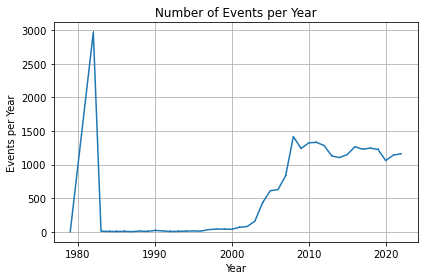

In [268]:
df['Event Date'] = pd.to_datetime(df['Event Date'])
df['Year'] = df['Event Date'].dt.year
events_per_year = df['Year'].value_counts().sort_index()

events_per_year.plot(kind= 'line', marker= ',')

plt.title('Number of Events per Year')
plt.xlabel('Year')
plt.ylabel('Events per Year')
plt.grid(True)
plt.tight_layout()
plt.show()

## Conclusion

## Limitations

## Recommendations

## Next Steps